In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt 

In [4]:
df=pd.read_csv('D:\Desktop\MAP535-Regression\Project\Abalone_data.csv', sep=',')

In [5]:
df=pd.get_dummies(df,columns=['Sex'])

In [6]:
np.random.seed(42)
#Splitting dataset in train and test using 70/30 method
indexes = np.random.choice(len(df),np.int(len(df)*0.7),replace=False)
df_train = df.loc[indexes]
df_test = df.loc[~(df.index.isin(indexes))]

In [7]:
df

,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,Rings,Sex_F,Sex_I,Sex_M
0,70,53,18,45.1,19.9,9.7,14.0,7,0,0,1
1,106,84,27,135.4,51.3,28.3,42.0,9,1,0,0
2,88,73,25,103.2,43.1,22.8,31.0,10,0,0,1
3,66,51,16,41.0,17.9,7.9,11.0,7,0,1,0
4,85,60,19,70.3,28.2,15.5,24.0,8,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
4171,113,90,33,177.4,74.0,47.8,49.8,11,1,0,0
4172,118,88,27,193.2,87.8,42.9,52.1,10,0,0,1
4173,120,95,41,235.2,105.1,57.5,61.6,9,0,0,1
4174,125,97,30,218.9,106.2,52.2,59.2,10,1,0,0


Q1: may be test 

Q2: Find the summary of each variables 

In [8]:
df.describe()

,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,Rings,Sex_F,Sex_I,Sex_M
count,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000,4176.000000
mean,104.801724,81.578305,27.905412,165.763506,71.879957,36.122534,47.770426,9.932471,0.312979,0.321360,0.365661
std,24.020509,19.849906,8.365278,98.084710,44.395943,21.924091,27.842510,3.223601,0.463761,0.467055,0.481673
min,15.000000,11.000000,0.000000,0.400000,0.200000,0.100000,0.300000,1.000000,0.000000,0.000000,0.000000
25%,90.000000,70.000000,23.000000,88.300000,37.200000,18.675000,26.000000,8.000000,0.000000,0.000000,0.000000
50%,109.000000,85.000000,28.000000,159.950000,67.200000,34.200000,46.800000,9.000000,0.000000,0.000000,0.000000
75%,123.000000,96.000000,33.000000,230.650000,100.400000,50.600000,65.800000,11.000000,1.000000,1.000000,1.000000
max,163.000000,130.000000,226.000000,565.100000,297.600000,152.000000,201.000000,29.000000,1.000000,1.000000,1.000000


In [41]:
df.iloc[:, :-3]

,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,Rings
0,70,53,18,45.1,19.9,9.7,14.0,7
1,106,84,27,135.4,51.3,28.3,42.0,9
2,88,73,25,103.2,43.1,22.8,31.0,10
3,66,51,16,41.0,17.9,7.9,11.0,7
4,85,60,19,70.3,28.2,15.5,24.0,8
...,...,...,...,...,...,...,...,...
4171,113,90,33,177.4,74.0,47.8,49.8,11
4172,118,88,27,193.2,87.8,42.9,52.1,10
4173,120,95,41,235.2,105.1,57.5,61.6,9
4174,125,97,30,218.9,106.2,52.2,59.2,10


<Figure size 864x720 with 0 Axes>

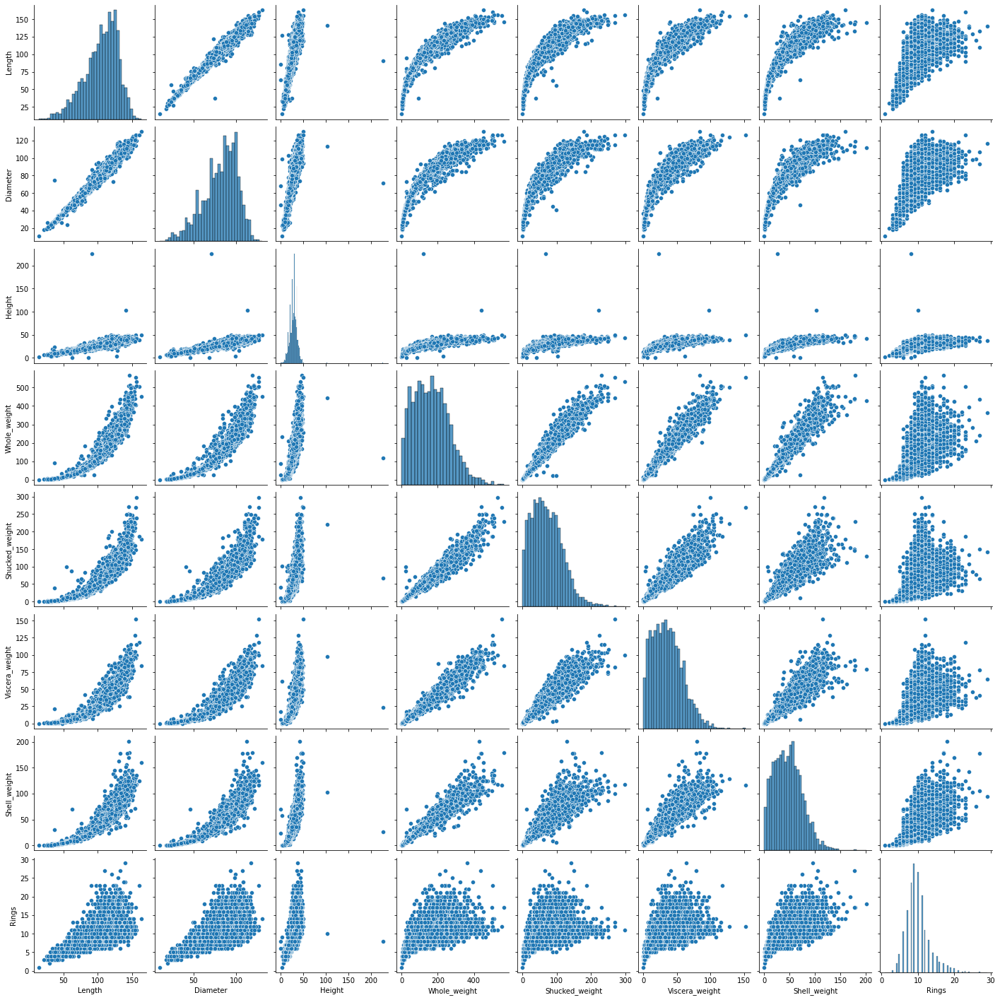

In [42]:
plt.figure(figsize=(12,10))
sns.pairplot(df.iloc[:, :-3]) 

In [ ]:
1) Length and Diameter are linear correlated.

2)

Q3: Generate the scatterplot

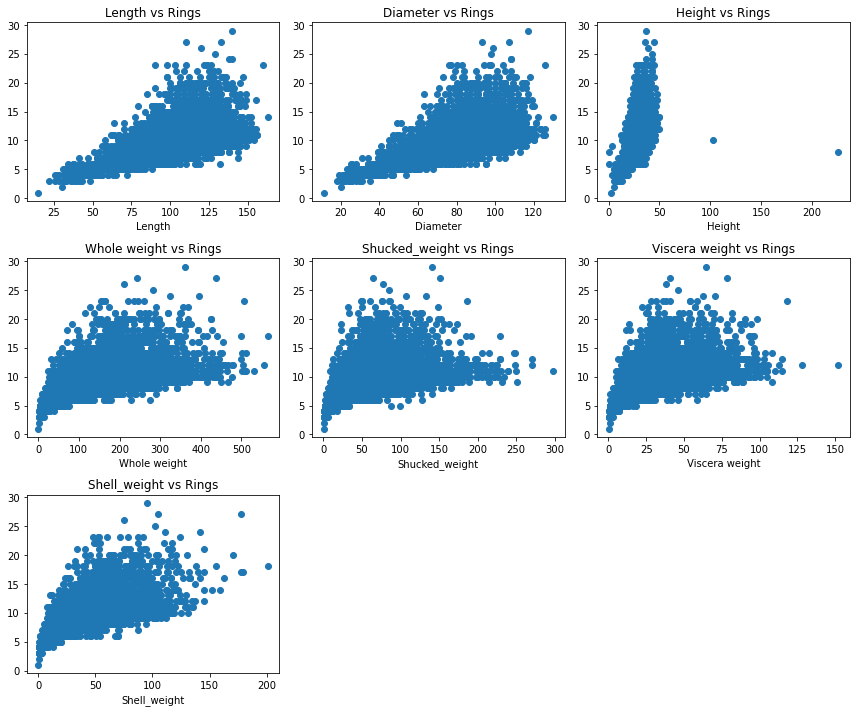

In [43]:
plt.figure(figsize=(12, 10))

plt.subplot(3,3,1)
plt.title('Length vs Rings')
plt.xlabel('Length')
plt.scatter(df['Length'], df['Rings'])

plt.subplot(3,3,2)
plt.title('Diameter vs Rings')
plt.xlabel('Diameter')
plt.scatter(df['Diameter'], df['Rings'])

plt.subplot(3,3,3)
plt.title('Height vs Rings')
plt.xlabel('Height')
plt.scatter(df['Height'], df['Rings'])

plt.subplot(3,3,4)
plt.title('Whole weight vs Rings')
plt.xlabel('Whole weight')
plt.scatter(df['Whole_weight'], df['Rings'])

plt.subplot(3,3,5)
plt.title('Shucked_weight vs Rings')
plt.xlabel('Shucked_weight')
plt.scatter(df['Shucked_weight'], df['Rings'])

plt.subplot(3,3,6)
plt.title('Viscera weight vs Rings')
plt.xlabel('Viscera weight')
plt.scatter(df['Viscera_weight'], df['Rings'])

plt.subplot(3,3,7)
plt.title('Shell_weight vs Rings')
plt.xlabel('Shell_weight')
plt.scatter(df['Shell_weight'], df['Rings'])


plt.tight_layout()

I do not agree with the hypothesis

Q4: Predict with linear regression

In [46]:
from patsy import dmatrices,dmatrix
import statsmodels.api as sm

y, X = dmatrices('Rings ~ Height', data=df, return_type='dataframe')
model = sm.OLS(y, X)
res = model.fit()
res.params

Intercept    3.930856
Height       0.215070
dtype: float64

Q5: scatterplot and linear regression line 

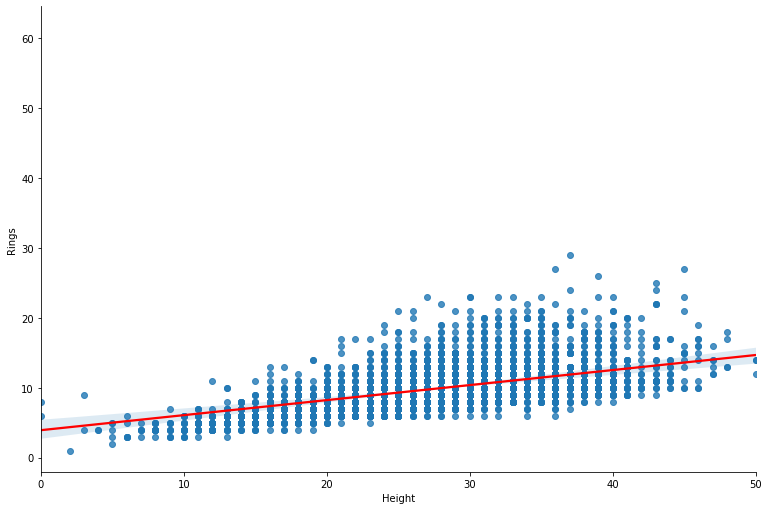

In [48]:
g = sns.lmplot(x="Height", y="Rings", data=df, aspect=1.5,height=7)
g.set(xlim=(None, 50))
regline = g.ax.get_lines()[0]
regline.set_color('red')

In [ ]:
Q6: 

In [22]:
# question 4
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
import time

In [29]:
scaler = StandardScaler()
model = make_pipeline(scaler, LinearRegression(fit_intercept=True))
model.fit(df_train['Height'].values.reshape(-1,1), df_train['Rings'].values.reshape(-1,1))

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('linearregression', LinearRegression())])

In [31]:
coef = model['linearregression'].coef_ 
intercept = model['linearregression'].intercept_
print(f"The coef is: {coef} and the intercept is:{intercept} ")

The coef is: [[1.77147283]] and the intercept is:[9.95552515] 
